# Resitive Crack EDA
---

### Introduction
---

A resitive crack is a crack in the solar panel that reduces performormance of the panel surounding the crack in addition to the crack itself. A resitive crack can be identified by the gradient emanating from the crack (Usually observed in the North/South direction). This gradient characteristice distingushise a crack from a resitive crack. This means there are two features that need to be identified, the first is the crack, the second is the gradient.

### Example of a Resistive Crack
---

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
# !conda install -c conda-forge tabulate -y
# !pip install scikit-learn

In [5]:
import os
import sys
import copy
import time
import tabulate
import numpy as np
sys.path.append(os.path.join(os.path.abspath(""), ".."))

In [6]:
from app.models import Classifier
from app.utils import ImageWrapper 
from app.transforms import FFT, IFFT, CreateOnesMask, PCA
from app.filters import CreateKernel, Convolve, Canny, HOG
from app.imager import ImageLoader, DefectViewer, Show, Exposure
from app.custom import RemoveBusBars, Orient, HighlightFrontGrid

In [7]:
seed = 1234

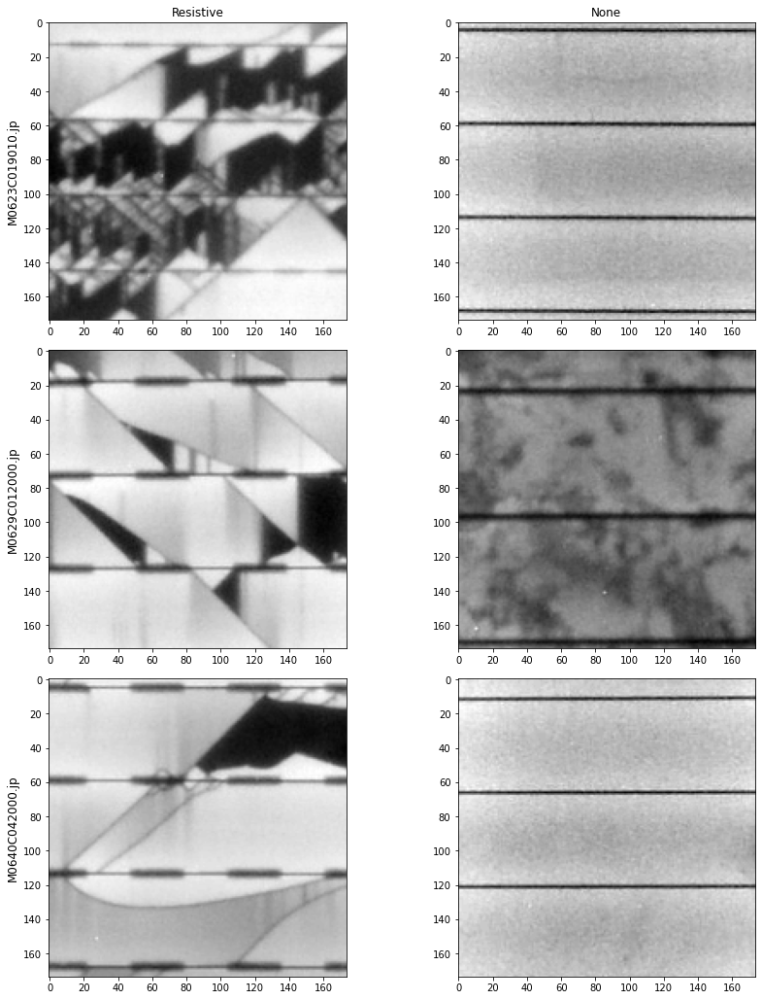

In [8]:
# Load 10 examples and name the category for it. Category is like a title for images
n_samples = 10
defect = (DefectViewer(row_chop=25, col_chop=25) << (ImageLoader(defect_class='Resistive') << n_samples))
defect.category = 'Resistive'
clean = (DefectViewer(row_chop=25, col_chop=25) << (ImageLoader(defect_class='None') << n_samples))
clean.category = 'None'

# View both the defect and the clean class
# I am using a tuple in this case as defect and clean are ImageWrapper objects
# Show random 5 out of the 10 images. Using the seed will ensure the same 5 are shown everytime
_ = Show(num_images=3, seed=seed) << (defect, clean)

In [9]:
## Create images with no Busbar
# Remove the BusBars
oriented_defect = Orient(num_jobs=20) << defect
oriented_clean = Orient(num_jobs=20) << clean
nobus_defect = RemoveBusBars() << oriented_defect
nobus_clean = RemoveBusBars() << oriented_clean

## FFT
---

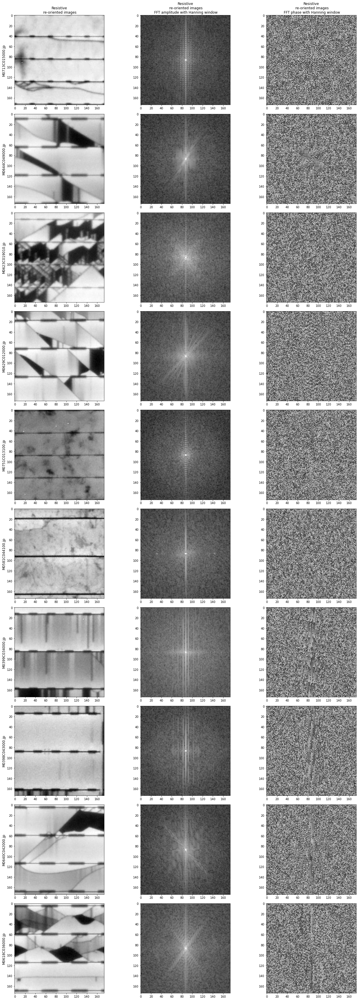

In [80]:
fft_images = FFT(dim=2) << oriented_defect
ft_images = Show(do_show=True) << fft_images

#### FFT With Defect
---

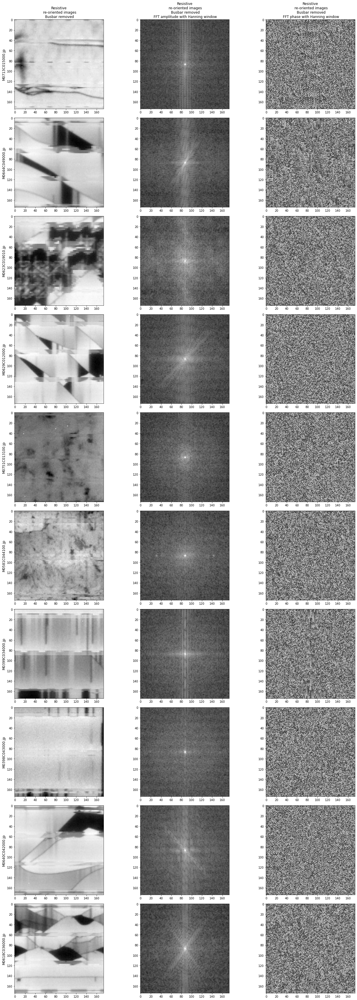

In [81]:
fft_images = FFT(dim=2) << nobus_defect
ft_images = Show(do_show=True) << fft_images

#### FFT Without Defect
---

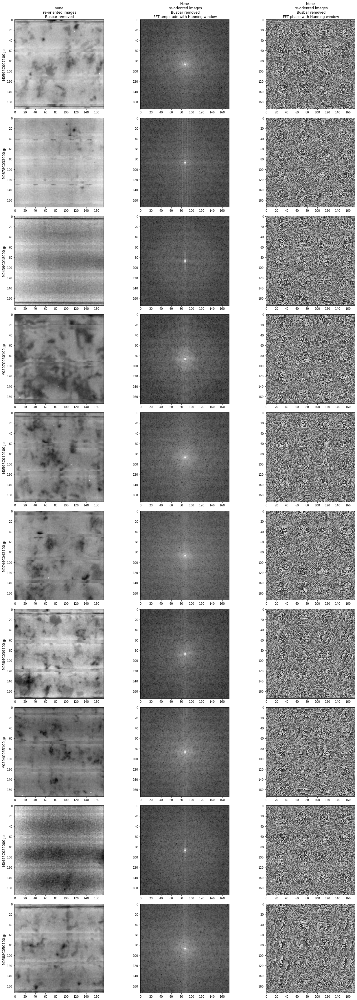

In [82]:
fft_images = FFT(dim=2) << nobus_clean
ft_images = Show(do_show=True) << fft_images

Removing the bus bar does reduce the signal found in the FFT, this may be a viable option to identify cracks and edges in the images. We could apply this to check if the image is clean or not prior to submitting it to aditional algorithims.


### Applying Gaussian Kernal
---

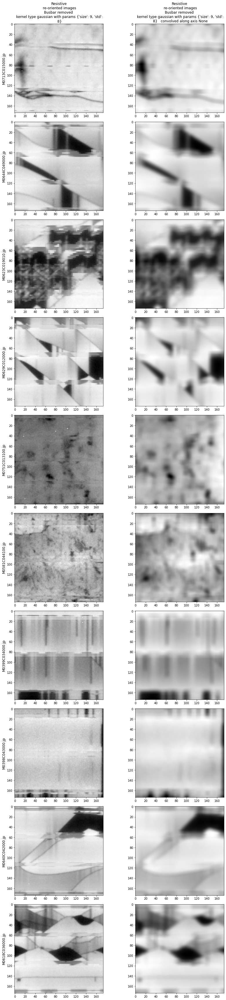

In [83]:
c_imgs = (Convolve() << (CreateKernel(dim=2, kernel='gaussian', size=9, std=8) << nobus_defect))
_ = Show('2dgaussian', do_show=True) << c_imgs

Note: The gaussian blurs the image reducing the sharpness of the cracks. This may be a way to identify fradients in the image.

### Applying the Soble kernal
---

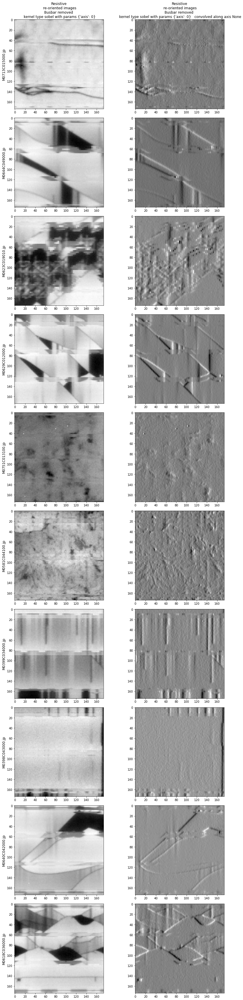

In [84]:
# X direction
c_imgs = (Convolve() << (CreateKernel(dim=2, kernel='sobel', axis=0) << nobus_defect))
_ = Show('2dgaussian', do_show=True) << c_imgs

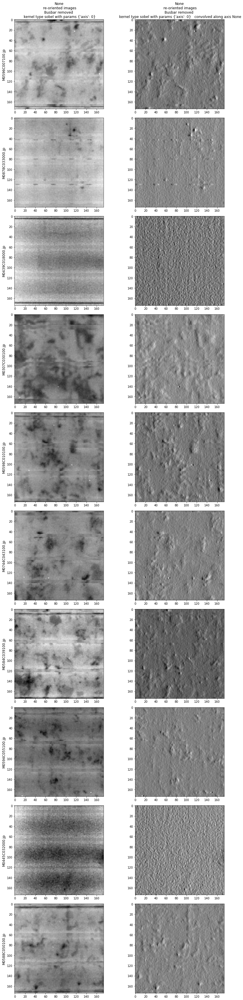

In [85]:
c_imgs = (Convolve() << (CreateKernel(dim=2, kernel='sobel', axis=0) << nobus_clean))
_ = Show('2dgaussian', do_show=True) << c_imgs

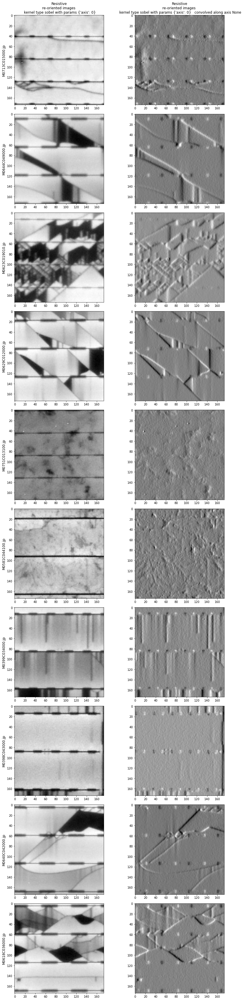

In [86]:
c_imgs = (Convolve() << (CreateKernel(dim=2, kernel='sobel', axis=0) << oriented_defect))
_ = Show('2dgaussian', do_show=True) << c_imgs

Note: the sobel filter does a great job in highlighting the high freqency parts of the image. The bus bar removal improves the sobel filters performance by removing the horizontal dots. 

Recomendaiton: Remove bus bars prior to running suble filter.

### Canny Filter
---

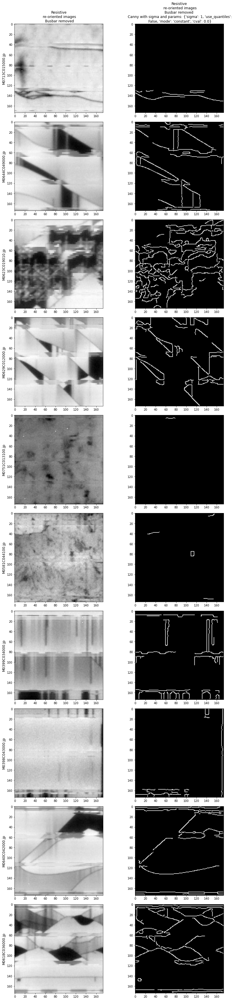

In [87]:
# without busbars
_ = Show('canny', do_show=True) << (Canny(sigma=1) <<  nobus_defect)

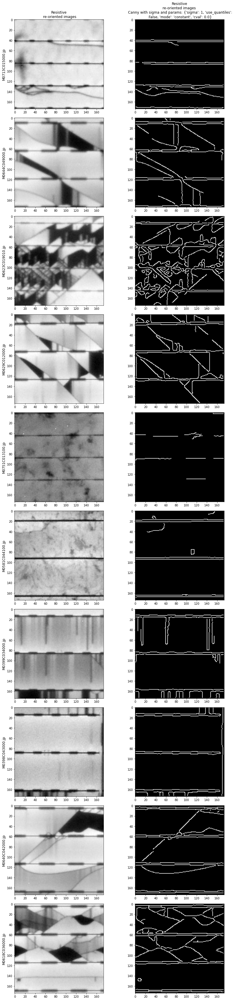

In [88]:
# With Busbars
_ = Show('canny', do_show=True) << (Canny(sigma=1) <<  oriented_defect)

NOTE: Works better prior to removing bus bars. Potential to run clean throuhg canny, take an average and remove for processed images.

### HOG
---

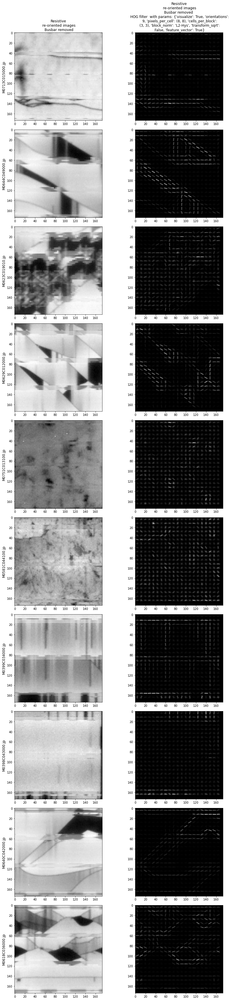

In [89]:
# Without Busbars
_ = Show('hog', do_show=True) << (HOG() <<  nobus_defect)

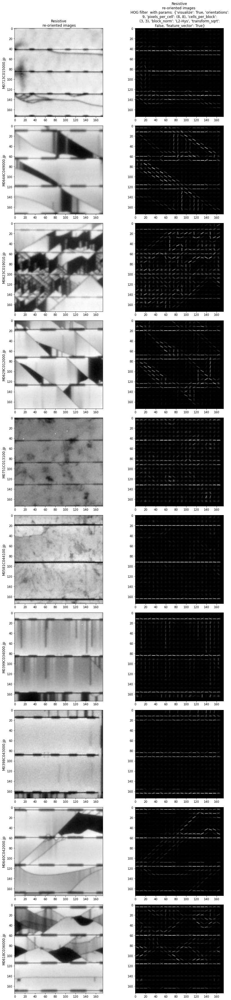

In [90]:
# Hog with busbars
_ = Show('hog', do_show=True) << (HOG() << oriented_defect)

Hog performs well identifying cracks but not gradients. Also works well with busbars removed prior to operaiton. Potential to use this to identify areas of interest....

## Exposure Settings
---

## Contrast Stretch
---

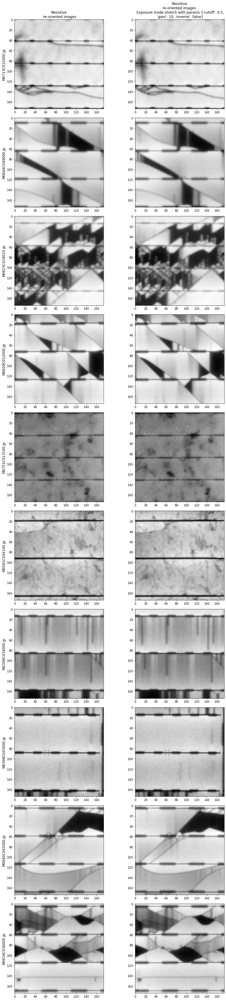

In [91]:
_ = Show('contrast_stretch') << (Exposure(mode='stretch') << oriented_defect)

NOTE: Contrats stretching has limmited to no impact on the images

## Histogram Equalization
---

In [92]:
_ = Show('histoequ') << (Exposure(mode='histo') << defect)

TypeError: equalize_hist() got an unexpected keyword argument 'cutoff'

In [ ]:
## Adaptive Equalization

In [ ]:
_ = Show('adaptive_histoequ') << (Exposure(mode='adaptive') << defect)

Noticible increase in contrast. May be benificial to run this through first prior to edge detection and gradient analysis

## Sigmoid
---

In [ ]:
_ = Show('sigmoid') << (Exposure(mode='sigmoid') << oriented_defect)

Noticable increase in identifying cracking. Notice it washes out gradients. May be good to run this through cracks?

## Invers Sigmoid
---

In [ ]:
_ = Show('sigmoid') << (Exposure(mode='sigmoid', inverse=True) << oriented_defect)

## Gamma
---

In [ ]:
_ = Show('gamma') << (Exposure(mode='gamma', gamma=0.2) << oriented_defect)

In [ ]:
## PCA

In [ ]:
PCA_imgs = PCA(transpose=False, n_components=3) << oriented_defect
_ = Show(do_show=True) << PCA_imgs

In [ ]:
PCA_imgs = PCA(transpose=False, n_components=3) << nobus_defect
_ = Show(do_show=True) << PCA_imgs

In [ ]:
PCA_imgs = PCA(transpose=False, n_components=3) << oriented_clean
_ = Show(do_show=True) << PCA_imgs

Note: Loss of high frequency components. This may be interesting for gradients....

## Gradient Research
---

Sources:
    https://pyimagesearch.com/2021/05/12/image-gradients-with-opencv-sobel-and-scharr/
    
    Try removing high frequency with FFT then applying a sobel filter

In [ ]:
## Open CV Sobel and Scharr

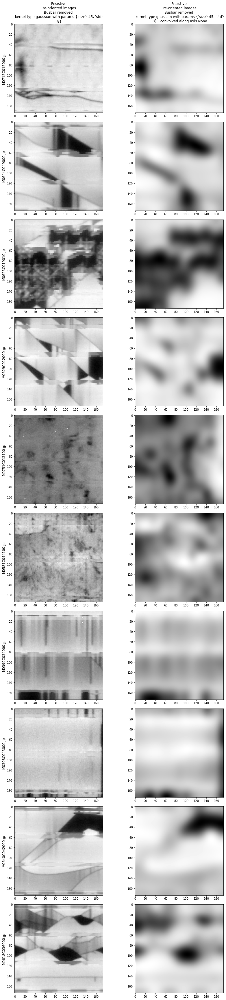

In [10]:
## FFT Filters (Like Homework) - Seperate object frequency
# Lowpass gaussian filter
c_imgs = (Convolve() << (CreateKernel(dim=2, kernel='gaussian', size=45, std=8) << nobus_defect))
_ = Show('2dgaussian', do_show=True) << c_imgs

Thought - We can run edge detection to identify the location of the crack
  if crack is found run it through gradient detection
     if gradient is determined process crack image by
         create 2 matrix, set column to 1 and row to 1 where crack is found
         sum and extract the 2s
         Set gradient areas to 1
         Sum and extract 3s
         if no 3s then gradient and crack do no overlap and not a resitive crack
         If 3s then resitive crack....

Subtract gaus from regular images

In [40]:
og = (~nobus_defect[0]) 

In [76]:
hf = (~nobus_defect[1]) - ~((Convolve() << (CreateKernel(dim=2, kernel='gaussian', size=30, std=3) << nobus_defect))[1])

In [77]:
iw_hf = ImageWrapper(hf, image_labels='Resistive', category=None)
iw_og = ImageWrapper(og, image_labels='Resistive', category=None)

In [78]:
tu = (iw_og, iw_hf)
tu = np.array(tu)

IndexError: string index out of range

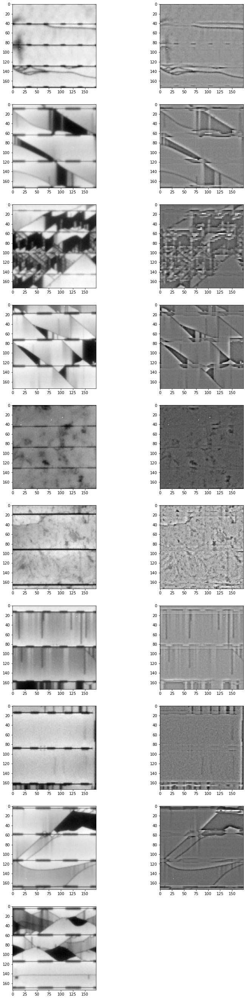

In [79]:
_ = Show(do_show=True) << tu